In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import mplhep as hep
from scipy.stats import norm
from scipy.optimize import curve_fit
from scipy.interpolate import UnivariateSpline
def configure_plotting():
    plt.rcParams['figure.facecolor'] = 'white'
    plt.rcParams['savefig.facecolor'] = 'white'
    plt.rcParams['savefig.bbox'] = 'tight'
    hep.style.use(hep.style.CMS)

# --- Load the pickle file ---
files = ["jets_R1_E0.pkl"]
closest_pairs_list = []
unpaired_reco_list = []
unpaired_truth_list = []
total_events = 0
for f in files:
    data = pd.read_pickle(f)
    df = data["closest_pairs"]
    max_event = df["event"].max()
    total_events += max_event
    closest_pairs_list.append(data["closest_pairs"])
    unpaired_reco_list.append(data["unpaired_reco"])
    unpaired_truth_list.append(data["unpaired_truth"])

closest_pairs = pd.concat(closest_pairs_list, ignore_index=True)
unpaired_reco = pd.concat(unpaired_reco_list, ignore_index=True)
unpaired_truth = pd.concat(unpaired_truth_list, ignore_index=True)

In [2]:
print("Reco")
print(len(unpaired_reco["eta"])+ len(closest_pairs["eta_reco"]))
print("Truth")
print(len(unpaired_truth["eta"]) + len(closest_pairs["eta_reco"]))
print("Pairs")
print(len(closest_pairs["eta_reco"]))
print("Efficiency")
print(100 * len(closest_pairs["eta_reco"]) / (len(unpaired_reco["eta"])+ len(closest_pairs["eta_reco"])))
print("Total events")
print(total_events)
# --- Combine reco jets (paired + unpaired) ---
# Paired reco jets come from closest_pairs
paired_reco = closest_pairs[["event", "reco_idx", "energy_reco", "eta_reco"]].copy()
paired_reco["paired"] = 1

# Unpaired reco jets are already given
unpaired_reco_df = unpaired_reco[["event", "reco_idx", "energy", "eta"]].copy()
unpaired_reco_df.rename(columns={"energy": "energy_reco", "eta": "eta_reco"}, inplace=True)
unpaired_reco_df["paired"] = 0

# Merge into a single dataframe
all_reco = pd.concat([paired_reco, unpaired_reco_df], ignore_index=True)

# Paired jets only
paired = closest_pairs.copy()

# Compute ratio
paired["energy_ratio"] = paired["energy_reco"] / paired["energy_truth"]
mask = paired["deltaR"] < 0.3
paired = paired[mask]

print("Reco")
print(len(unpaired_reco["eta"])+ len(closest_pairs["eta_reco"]))
print("Truth")
print(len(unpaired_truth["eta"]) + len(closest_pairs["eta_reco"]))
print("Pairs")
print(len(closest_pairs["eta_reco"]))
print("Efficiency")
print(100 * len(closest_pairs["eta_reco"]) / (len(unpaired_reco["eta"])+ len(closest_pairs["eta_reco"])))
print("Total events")
print(total_events)


Reco
25429601
Truth
29820464
Pairs
17877539
Efficiency
70.30208220726703
Total events
19944679
Reco
25429601
Truth
29820464
Pairs
17877539
Efficiency
70.30208220726703
Total events
19944679


In [3]:
# --- Apply deltaR cut to define valid pairs ---
dr_cut = 0.3

paired_good = closest_pairs[closest_pairs["deltaR"] < dr_cut].copy()
paired_bad  = closest_pairs[closest_pairs["deltaR"] >= dr_cut].copy()

# --- Rebuild unpaired reco jets ---
# original unpaired reco
unpaired_reco_df = unpaired_reco[["event", "reco_idx", "energy", "eta"]].copy()
unpaired_reco_df.rename(columns={"energy": "energy_reco", "eta": "eta_reco"}, inplace=True)

# reco jets that failed deltaR matching are now unpaired
failed_reco = paired_bad[["event", "reco_idx", "energy_reco", "eta_reco"]].copy()

# combined unpaired reco
unpaired_reco_after = pd.concat(
    [unpaired_reco_df, failed_reco],
    ignore_index=True
)

# --- Rebuild unpaired truth jets ---
unpaired_truth_df = unpaired_truth[["event", "truth_idx", "energy", "eta"]].copy()
unpaired_truth_df.rename(
    columns={"energy": "energy_truth", "eta": "eta_truth"},
    inplace=True
)

failed_truth = paired_bad[["event", "truth_idx", "energy_truth", "eta_truth"]].copy()

unpaired_truth_after = pd.concat(
    [unpaired_truth_df, failed_truth],
    ignore_index=True
)


# --- Final counts ---
n_pairs = len(paired_good)
n_reco_total = len(unpaired_reco_after) + n_pairs
n_truth_total = len(unpaired_truth_after) + n_pairs

print("Reco")
print(n_reco_total)

print("Truth")
print(n_truth_total)

print("Pairs")
print(n_pairs)

print("Efficiency")
print(100.0 * n_pairs / n_reco_total)

print("Total events")
print(total_events)


Reco
25429601
Truth
29820464
Pairs
12280447
Efficiency
48.291937415769915
Total events
19944679


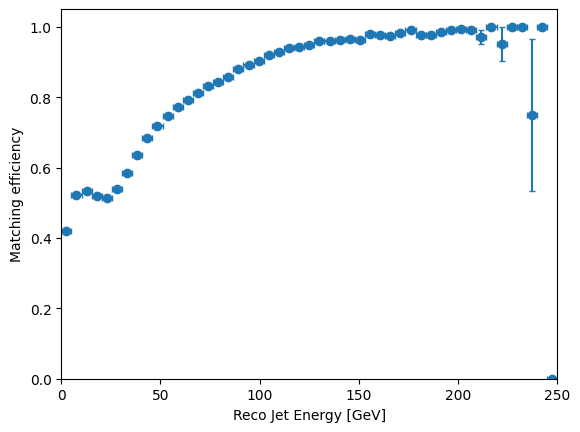

In [4]:
import numpy as np
import matplotlib.pyplot as plt

# --- Inputs ---
# paired_good: reco–truth matches with deltaR < cut
# all_reco: all reco jets (paired + unpaired), with column "energy_reco"

e_bins = np.linspace(0, 250, 50)  # adjust as needed
bin_centers = 0.5 * (e_bins[1:] + e_bins[:-1])
bin_widths = np.diff(e_bins)

# --- Histogram counts ---
matched_counts, _ = np.histogram(paired_good["energy_reco"], bins=e_bins)
total_counts, _   = np.histogram(all_reco["energy_reco"], bins=e_bins)

# --- Efficiency and binomial errors ---
eff = np.zeros_like(matched_counts, dtype=float)
err = np.zeros_like(matched_counts, dtype=float)

mask = total_counts > 0
eff[mask] = matched_counts[mask] / total_counts[mask]
err[mask] = np.sqrt(eff[mask] * (1 - eff[mask]) / total_counts[mask])

# --- Plot ---
plt.figure()
plt.errorbar(
    bin_centers,
    eff,
    yerr=err,
    xerr=bin_widths / 2,
    fmt="o",
    capsize=2
)

plt.xlabel("Reco Jet Energy [GeV]")
plt.ylabel("Matching efficiency")
plt.ylim(0, 1.05)
plt.xlim(0, 250)
plt.show()


Processing phi bin 0: -3.14–-2.36


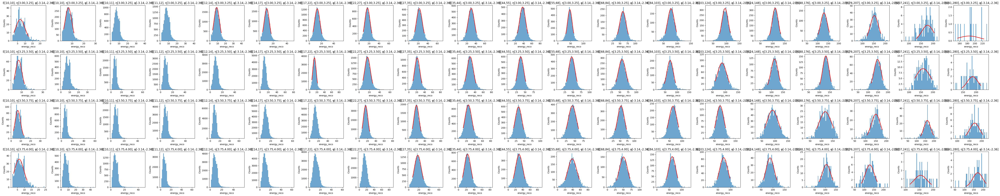

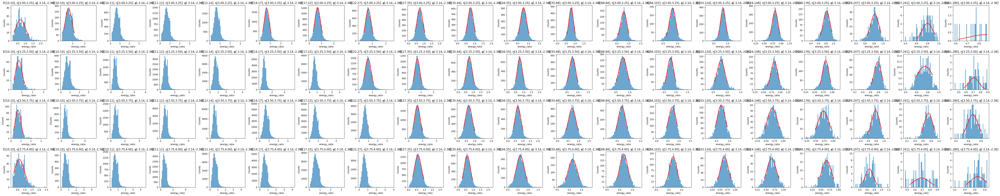

Processing phi bin 1: -2.36–-1.57


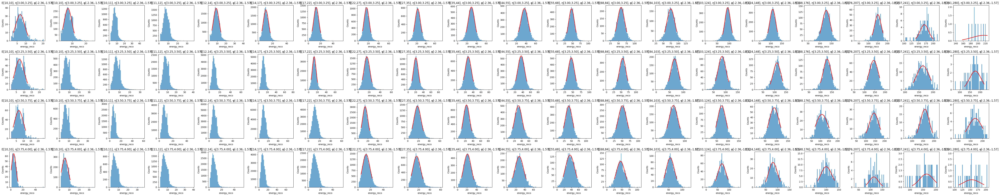

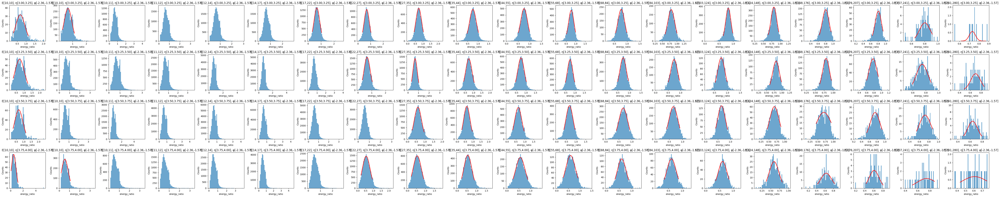

Processing phi bin 2: -1.57–-0.79


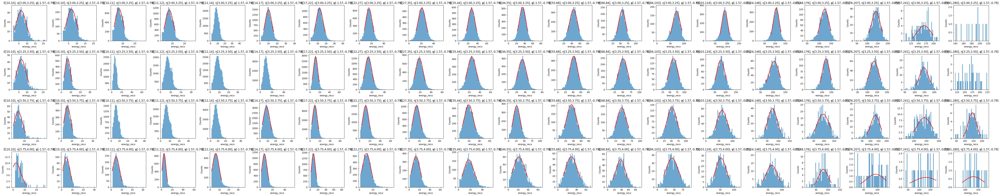

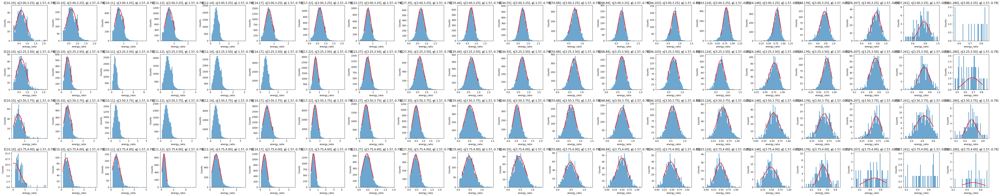

Processing phi bin 3: -0.79–0.00


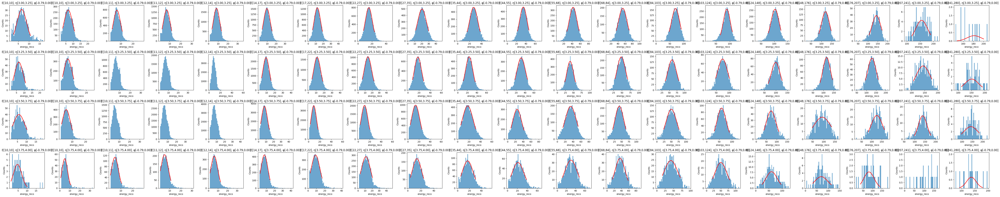

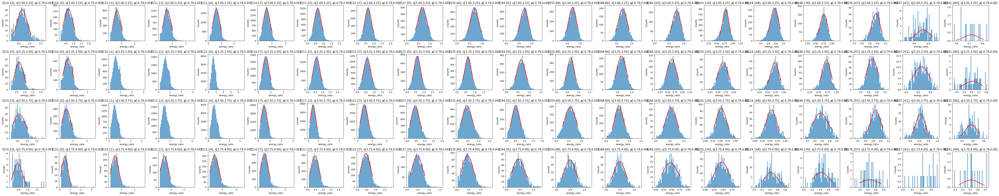

Processing phi bin 4: 0.00–0.79


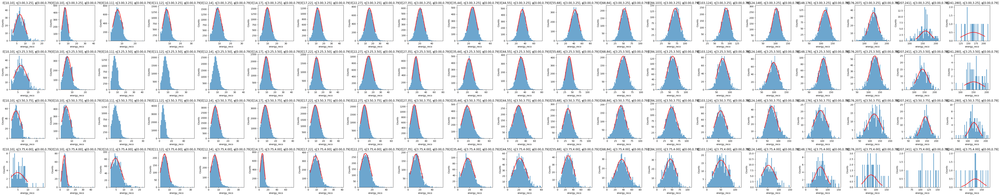

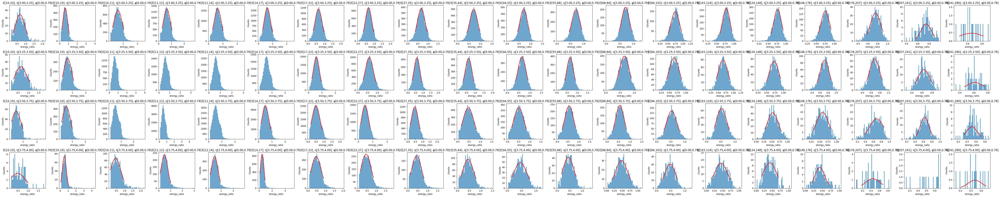

Processing phi bin 5: 0.79–1.57


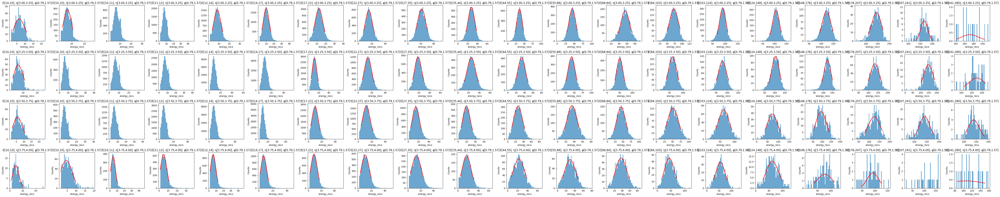

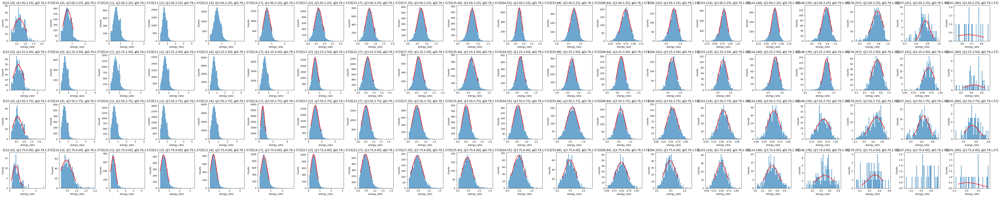

Processing phi bin 6: 1.57–2.36


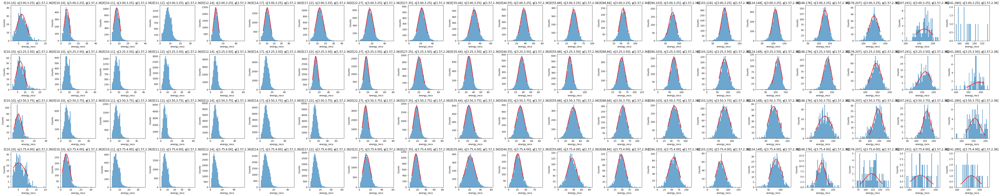

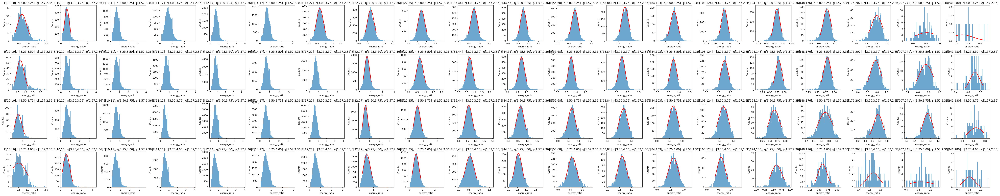

Processing phi bin 7: 2.36–3.14


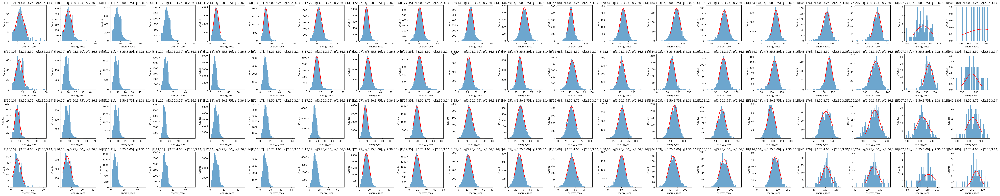

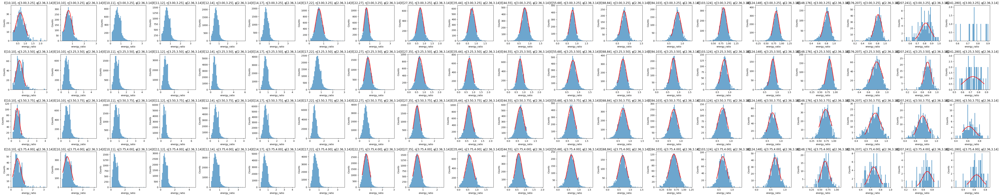

In [5]:
fit_results_response = []
fit_results_scale = []

# ------------------------------------------------------
# Configuration
# ------------------------------------------------------
E0 = 10
Emax = 280
n_bins_E = 20
p = 3.0

x = np.linspace(0, 1, n_bins_E + 1)
e_bins = E0 + (Emax - E0) * x**p

eta_min, eta_max = 3.0, 4.0
n_eta_bins = 4
eta_bins = np.linspace(eta_min, eta_max, n_eta_bins + 1)

phi_min, phi_max = -np.pi, np.pi
n_phi_bins = 8
phi_bins = np.linspace(phi_min, phi_max, n_phi_bins + 1)

min_points_for_fit = 1
n_hist_bins = 50
chi2_lim = 10

asym = 1
n_sigma = 1.5

# ------------------------------------------------------
# Helper functions
# ------------------------------------------------------
def gauss(x, A, mu, sigma):
    return A * np.exp(-(x - mu)**2 / (2 * sigma**2))

def reduced_chi2(y_obs, y_fit, y_err=None, n_params=3):
    if y_err is None:
        y_err = np.sqrt(np.maximum(y_obs, 1))
    chi2 = np.sum(((y_obs - y_fit) / y_err)**2)
    dof = len(y_obs) - n_params
    return np.inf if dof <= 0 else chi2 / dof


# ======================================================
# Main Loop over φ, η, energy
# ======================================================
for k in range(len(phi_bins)-1):
    phi_low, phi_high = phi_bins[k], phi_bins[k+1]
    phi_center = 0.5*(phi_low + phi_high)

    print(f"Processing phi bin {k}: {phi_low:.2f}–{phi_high:.2f}")

    # ------------------------------------------------------
    # Create figure grids for this φ slice
    # ------------------------------------------------------
    fig_resp, axes_resp = plt.subplots(
        len(eta_bins)-1, len(e_bins)-1,
        figsize=(3*(len(e_bins)-1), 3*(len(eta_bins)-1))
    )
    fig_scale, axes_scale = plt.subplots(
        len(eta_bins)-1, len(e_bins)-1,
        figsize=(3*(len(e_bins)-1), 3*(len(eta_bins)-1))
    )

    # Ensure 2D array indexing
    if axes_resp.ndim == 1:
        axes_resp = np.expand_dims(axes_resp, axis=0)
    if axes_scale.ndim == 1:
        axes_scale = np.expand_dims(axes_scale, axis=0)

    # ------------------------------------------------------
    # Loop over η
    # ------------------------------------------------------
    for j in range(len(eta_bins)-1):
        eta_low, eta_high = eta_bins[j], eta_bins[j+1]
        eta_center = 0.5*(eta_low + eta_high)

        # ------------------------------------------------------
        # Loop over energy
        # ------------------------------------------------------
        for i in range(len(e_bins)-1):
            e_low, e_high = e_bins[i], e_bins[i+1]
            center_energy = 0.5*(e_low + e_high)

            ax_resp = axes_resp[j, i]
            ax_scale = axes_scale[j, i]

            # ------------------------------------------------------
            # Mask including φ
            # ------------------------------------------------------
            mask = (
                (paired["energy_truth"] >= e_low) &
                (paired["energy_truth"] <  e_high) &
                (paired["eta_reco"]    >= eta_low) &
                (paired["eta_reco"]    <  eta_high) &
                (paired["phi_reco"]    >= phi_low) &
                (paired["phi_reco"]    <  phi_high)
            )

            reco_in_bin  = paired.loc[mask, "energy_reco"].values
            ratio_in_bin = paired.loc[mask, "energy_ratio"].values

            # Titles
            title = (
                f"E[{e_low:.0f},{e_high:.0f}], "
                f"η[{eta_low:.2f},{eta_high:.2f}], "
                f"φ[{phi_low:.2f},{phi_high:.2f}]"
            )
            ax_resp.set_title(title)
            ax_resp.set_xlabel("energy_reco")
            ax_resp.set_ylabel("Counts")
            ax_scale.set_title(title)
            ax_scale.set_xlabel("energy_ratio")
            ax_scale.set_ylabel("Counts")

            # Histograms
            if len(reco_in_bin) > 0:
                ax_resp.hist(reco_in_bin, bins=n_hist_bins, alpha=0.65)
            if len(ratio_in_bin) > 0:
                ax_scale.hist(ratio_in_bin, bins=n_hist_bins, alpha=0.65)

            # ------------------------------------------------------
            # RESPONSE FIT
            # ------------------------------------------------------
            if len(reco_in_bin) >= min_points_for_fit:

                mu0 = reco_in_bin.mean()
                sigma0 = reco_in_bin.std()

                fit_mask = (
                    (reco_in_bin >= mu0 - n_sigma*sigma0) &
                    (reco_in_bin <= mu0 + n_sigma*sigma0*asym)
                )
                reco_fit_region = reco_in_bin[fit_mask]

                if len(reco_fit_region) >= min_points_for_fit:

                    counts, edges = np.histogram(reco_in_bin, bins=n_hist_bins)
                    bin_centers = 0.5*(edges[:-1] + edges[1:])
                    bin_widths  = np.diff(edges)
                    total_entries = counts.sum()

                    density = counts / (total_entries * bin_widths)
                    errors = np.sqrt(counts) / (total_entries * bin_widths)
                    errors[errors == 0] = errors[errors > 0].min()

                    fit_mask_bins = (
                        (bin_centers >= mu0 - n_sigma*sigma0) &
                        (bin_centers <= mu0 + n_sigma*sigma0*asym)
                    )

                    x_fit = bin_centers[fit_mask_bins]
                    y_fit = density[fit_mask_bins]
                    y_err = errors[fit_mask_bins]

                    if len(x_fit) >= 3:

                        p0 = [y_fit.max(), mu0, sigma0]
                        try:
                            popt, pcov = curve_fit(
                                gauss, x_fit, y_fit,
                                p0=p0, sigma=y_err,
                                absolute_sigma=True
                            )
                            mu_fit, sigma_fit = popt[1], popt[2]
                            mu_err, sigma_err = np.sqrt(np.diag(pcov))[1:3]
                            chi2_ndf = reduced_chi2(
                                y_fit, gauss(x_fit, *popt), y_err
                            )

                            valid_mu = (
                                mu0 - n_sigma*sigma0 <= mu_fit <=
                                mu0 + n_sigma*sigma0*asym
                            )

                            if chi2_ndf <= chi2_lim and valid_mu:

                                fit_results_response.append({
                                    "center_energy": center_energy,
                                    "energy_range": (e_low, e_high),
                                    "eta_center": eta_center,
                                    "eta_range": (eta_low, eta_high),
                                    "phi_center": phi_center,
                                    "phi_range": (phi_low, phi_high),
                                    "mu": mu_fit,
                                    "mu_err": mu_err,
                                    "sigma": sigma_fit,
                                    "sigma_err": sigma_err,
                                    "chi2_ndf": chi2_ndf
                                })

                                # Plot Gaussian overlay
                                x_dense = np.linspace(
                                    mu0 - n_sigma*sigma0,
                                    mu0 + n_sigma*sigma0*asym, 400
                                )
                                y_dense = gauss(x_dense, *popt)
                                ax_resp.plot(
                                    x_dense,
                                    y_dense * total_entries * bin_widths.mean(),
                                    "r-", linewidth=2
                                )

                        except (RuntimeError, ValueError):
                            pass

            # ------------------------------------------------------
            # SCALE FIT
            # ------------------------------------------------------
            if len(ratio_in_bin) >= min_points_for_fit:

                mu0_r = ratio_in_bin.mean()
                sigma0_r = ratio_in_bin.std()

                fit_mask_r = (
                    (ratio_in_bin >= mu0_r - n_sigma*sigma0_r) &
                    (ratio_in_bin <= mu0_r + n_sigma*sigma0_r*asym)
                )
                ratio_fit_region = ratio_in_bin[fit_mask_r]

                if len(ratio_fit_region) >= min_points_for_fit:

                    counts_r, edges_r = np.histogram(
                        ratio_in_bin, bins=n_hist_bins
                    )
                    bin_centers_r = 0.5*(edges_r[:-1] + edges_r[1:])
                    bin_widths_r  = np.diff(edges_r)
                    total_entries_r = counts_r.sum()

                    density_r = counts_r / (total_entries_r * bin_widths_r)
                    errors_r = np.sqrt(counts_r) / (total_entries_r * bin_widths_r)
                    errors_r[errors_r == 0] = errors_r[errors_r > 0].min()

                    fit_mask_bins_r = (
                        (bin_centers_r >= mu0_r - n_sigma*sigma0_r) &
                        (bin_centers_r <= mu0_r + n_sigma*sigma0_r*asym)
                    )

                    x_fit_r = bin_centers_r[fit_mask_bins_r]
                    y_fit_r = density_r[fit_mask_bins_r]
                    y_err_r = errors_r[fit_mask_bins_r]

                    if len(x_fit_r) >= 3:

                        p0_r = [y_fit_r.max(), mu0_r, sigma0_r]

                        try:
                            popt_r, pcov_r = curve_fit(
                                gauss, x_fit_r, y_fit_r,
                                p0=p0_r, sigma=y_err_r,
                                absolute_sigma=True
                            )
                            mu_fit_r, sigma_fit_r = popt_r[1], popt_r[2]
                            mu_err_r, sigma_err_r = np.sqrt(np.diag(pcov_r))[1:3]
                            chi2_ndf_r = reduced_chi2(
                                y_fit_r, gauss(x_fit_r, *popt_r), y_err_r
                            )

                            valid_mu_r = (
                                mu0_r - n_sigma*sigma0_r <= mu_fit_r <=
                                mu0_r + n_sigma*sigma0_r*asym
                            )

                            if chi2_ndf_r <= chi2_lim and valid_mu_r:

                                fit_results_scale.append({
                                    "center_energy": center_energy,
                                    "energy_range": (e_low, e_high),
                                    "eta_center": eta_center,
                                    "eta_range": (eta_low, eta_high),
                                    "phi_center": phi_center,
                                    "phi_range": (phi_low, phi_high),
                                    "mu": mu_fit_r,
                                    "mu_err": mu_err_r,
                                    "sigma": sigma_fit_r,
                                    "sigma_err": sigma_err_r,
                                    "chi2_ndf": chi2_ndf_r
                                })

                                x_dense_r = np.linspace(
                                    mu0_r - n_sigma*sigma0_r,
                                    mu0_r + n_sigma*sigma0_r*asym, 400
                                )
                                y_dense_r = gauss(x_dense_r, *popt_r)
                                ax_scale.plot(
                                    x_dense_r,
                                    y_dense_r * total_entries_r * bin_widths_r.mean(),
                                    "r-", linewidth=2
                                )

                        except (RuntimeError, ValueError):
                            pass

    # End phi slice plots
    fig_resp.tight_layout()
    fig_scale.tight_layout()
    plt.show()


# ======================================================
# Build final DataFrames
# ======================================================
df_fit_response = pd.DataFrame(fit_results_response)
df_fit_scale = pd.DataFrame(fit_results_scale)

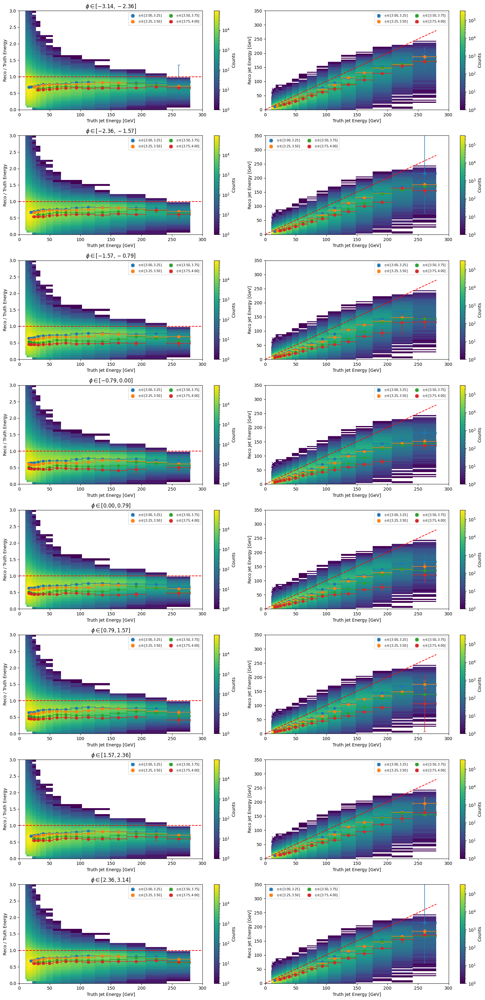

In [6]:
truth_ecut = 15

mask = df_fit_response["center_energy"] > truth_ecut
df_fit_response = df_fit_response[mask].copy()

mask = df_fit_scale["center_energy"] > truth_ecut
df_fit_scale = df_fit_scale[mask].copy()

# --- 2D histogram parameters ---
x_bins = e_bins
y_bins_ratio = np.linspace(0, 3, 50)
y_bins_reco = np.linspace(0, 350, 100)

# ==========================================================
# Unique phi bins
# ==========================================================
phi_bins_unique = df_fit_scale["phi_range"].apply(tuple).unique()
phi_bins_unique = sorted(phi_bins_unique)  # clean ordering

n_phi = len(phi_bins_unique)

# ==========================================================
# Construct figure with rows = phi bins, columns = (ratio, reco)
# ==========================================================
fig, axes = plt.subplots(
    n_phi, 2,
    figsize=(16, 4 * n_phi)
)

# If only one phi bin, axes won't be 2D
if n_phi == 1:
    axes = np.array([axes])

# ==========================================================
# Loop over phi bins
# ==========================================================
for i, phi_range in enumerate(phi_bins_unique):

    # ------------------------------------------------------
    # (1) Energy Scale (ratio)
    # ------------------------------------------------------
    ax = axes[i, 0]

    hist_ratio = ax.hist2d(
        paired["energy_truth"],
        paired["energy_ratio"],
        bins=[x_bins, y_bins_ratio],
        cmap="viridis",
        norm=mcolors.LogNorm()
    )
    fig.colorbar(hist_ratio[3], ax=ax, label="Counts")

    ax.set_ylabel("Reco / Truth Energy")
    #if i == n_phi - 1:
    ax.set_xlabel("Truth Jet Energy [GeV]")

    # Overlay scale fit (group by eta for this phi)
    for eta_range, df_sel in (
        df_fit_scale[df_fit_scale["phi_range"].apply(tuple) == phi_range]
        .groupby(df_fit_scale["eta_range"].apply(tuple))
    ):
        e_range_width = 0.5 * df_sel["energy_range"].apply(lambda x: x[1] - x[0])

        eta_label = f"[{eta_range[0]:.2f},{eta_range[1]:.2f}]"
        phi_label = f"[{phi_range[0]:.2f},{phi_range[1]:.2f}]"

        ax.errorbar(
            df_sel["center_energy"],
            df_sel["mu"],
            yerr=df_sel["mu_err"],
            xerr=e_range_width,
            fmt='o',
            elinewidth=1.2,
            capsize=3,
            label=fr"$\eta\in{eta_label}$"
        )
    ax.set_xlim(0, 300)
    ax.axhline(1.0, color='red', linestyle='--', lw=1.5)
    ax.set_title(fr"$\phi\in[{phi_range[0]:.2f},{phi_range[1]:.2f}]$")
    ax.legend(fontsize=7, ncol=2)

    # ------------------------------------------------------
    # (2) Energy Response (absolute reco)
    # ------------------------------------------------------
    ax = axes[i, 1]

    hist_reco = ax.hist2d(
        paired["energy_truth"],
        paired["energy_reco"],
        bins=[x_bins, y_bins_reco],
        cmap="viridis",
        norm=mcolors.LogNorm()
    )
    fig.colorbar(hist_reco[3], ax=ax, label="Counts")

    #if i == n_phi - 1:
    ax.set_xlabel("Truth Jet Energy [GeV]")
    ax.set_ylabel("Reco Jet Energy [GeV]")
    ax.set_xlim(0, 300)

    for eta_range, df_sel in (
        df_fit_response[df_fit_response["phi_range"].apply(tuple) == phi_range]
        .groupby(df_fit_response["eta_range"].apply(tuple))
    ):
        e_range_width = 0.5 * df_sel["energy_range"].apply(lambda x: x[1] - x[0])

        eta_label = f"[{eta_range[0]:.2f},{eta_range[1]:.2f}]"

        ax.errorbar(
            df_sel["center_energy"],
            df_sel["mu"],
            yerr=df_sel["mu_err"],
            xerr=e_range_width,
            fmt='o',
            elinewidth=1.2,
            capsize=3,
            label=fr"$\eta\in{eta_label}$"
        )

    x_line = np.array([0, x_bins.max()])
    ax.plot(x_line, x_line, color='red', linestyle='--', lw=1.5)
    ax.legend(fontsize=7, ncol=2)

plt.tight_layout()
plt.show()


In [7]:
from scipy.interpolate import UnivariateSpline
import numpy as np
import matplotlib.pyplot as plt

# df_fit_scale must contain:
#   "eta_range"  -> tuple (eta_min, eta_max)
#   "phi_range"  -> tuple (phi_min, phi_max)
#   "center_energy", "mu", "mu_err", "energy_range"

# ------------------------------------------------------------
# Build splines for every (eta_range, phi_range)
# ------------------------------------------------------------
splines = {}

group_cols = [
    df_fit_scale["eta_range"].apply(tuple),
    df_fit_scale["phi_range"].apply(tuple)
]

for (eta_range, phi_range), df_bin in df_fit_scale.groupby(group_cols):
    x_vals = df_bin["center_energy"].values
    y_vals = df_bin["mu"].values
    y_err = df_bin["mu_err"].values

    # Sort
    order = np.argsort(x_vals)
    x_sorted = x_vals[order]
    y_sorted = y_vals[order]
    y_err_sorted = y_err[order]

    # Exclude first point
    x_fit = x_sorted[2:]
    y_fit = y_sorted[2:]
    w_fit = 1 / np.maximum(y_err_sorted[2:], 1e-6)

    spline = UnivariateSpline(x_fit, y_fit, w=w_fit, k=2, s=10000)

    splines[(eta_range, phi_range)] = {
        "spline": spline,
        "x_max": x_sorted.max(),
        "y_max": spline(x_sorted.max())
    }

# ------------------------------------------------------------
# JES(RecoE, eta, phi)
# ------------------------------------------------------------
def JES(reco_energy, eta, phi):
    reco_energy = np.asarray(reco_energy)
    eta = np.asarray(eta)
    phi = np.asarray(phi)

    out = np.empty_like(reco_energy, dtype=float)
    assigned = np.zeros_like(reco_energy, dtype=bool)

    for (eta_range, phi_range), info in splines.items():
        eta_min, eta_max = eta_range
        phi_min, phi_max = phi_range

        mask = (
            (eta >= eta_min) & (eta < eta_max) &
            (phi >= phi_min) & (phi < phi_max)
        )

        if not np.any(mask):
            continue

        spline = info["spline"]
        x_max = info["x_max"]
        y_max = info["y_max"]

        mask_low = mask & (reco_energy <= x_max)
        mask_high = mask & (reco_energy > x_max)

        out[mask_low] = spline(reco_energy[mask_low])
        out[mask_high] = y_max
        assigned[mask] = True

    # Fallback
    out[~assigned] = 1.0
    return out

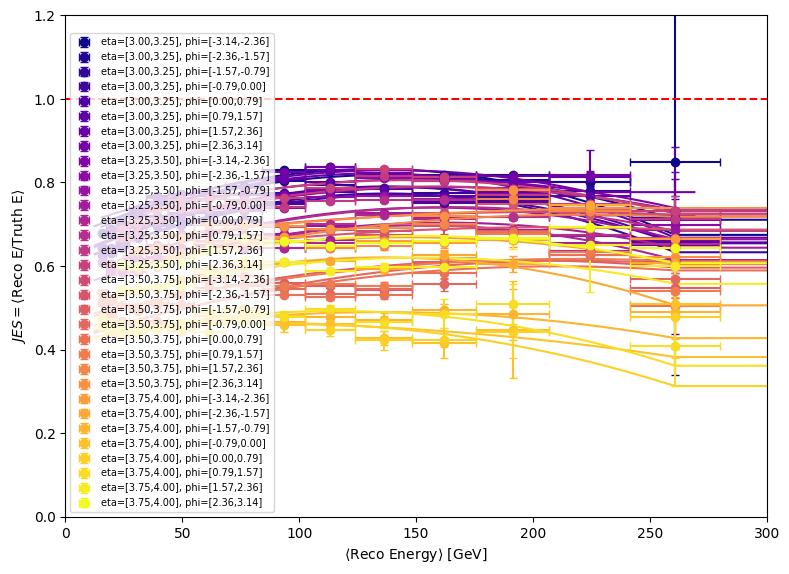

In [8]:
# ------------------------------------------------------------
# Plot: each (eta, phi) bin as a separate curve
# ------------------------------------------------------------
plt.figure(figsize=(8,6))
colors = plt.cm.plasma(np.linspace(0,1,len(splines)))

for ((eta_range, phi_range), info), c in zip(splines.items(), colors):
    df_bin = df_fit_scale[
        (df_fit_scale["eta_range"].apply(tuple) == eta_range) &
        (df_fit_scale["phi_range"].apply(tuple) == phi_range)
    ]

    x_vals = df_bin["center_energy"].values
    y_vals = df_bin["mu"].values
    x_err = 0.5 * df_bin["energy_range"].apply(lambda r: r[1]-r[0])
    y_err = df_bin["mu_err"].values

    label = (
        f"eta=[{eta_range[0]:.2f},{eta_range[1]:.2f}], "
        f"phi=[{phi_range[0]:.2f},{phi_range[1]:.2f}]"
    )

    plt.errorbar(
        x_vals, y_vals,
        xerr=x_err, yerr=y_err,
        fmt='o', color=c, ecolor=c, capsize=3, label=label
    )

    x_fine = np.linspace(x_vals.min()*0.8, x_vals.max()*1.2, 600)
    spline = info["spline"]
    y_max = info["y_max"]
    y_fine = np.where(x_fine <= info["x_max"], spline(x_fine), y_max)

    plt.plot(x_fine, y_fine, '-', color=c)

plt.axhline(1.0, color='red', linestyle='--', linewidth=1.5)
plt.xlabel(r"$\langle \mathrm{Reco\ Energy} \rangle$ [GeV]")
plt.ylabel(r"$JES = \langle \mathrm{Reco\ E} / \mathrm{Truth\ E} \rangle$")
plt.ylim(0, 1.2)
plt.xlim(0, 300)
plt.legend(loc='lower left', fontsize=7)
plt.tight_layout()
plt.show()

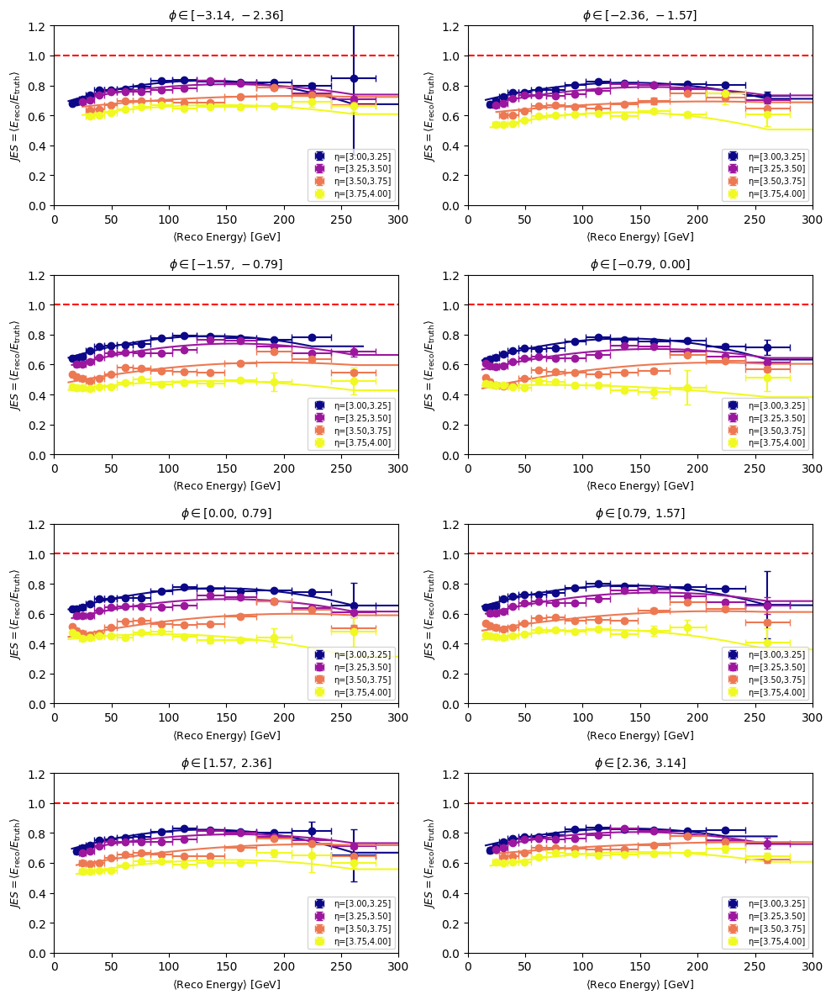

In [9]:
# ------------------------------------------------------------
# Plot: 4×2 grid of subplots, each with its own axis labels
# ------------------------------------------------------------
phi_ranges = sorted({phi for (_, phi) in splines.keys()})
eta_ranges = sorted({eta for (eta, _) in splines.keys()})

nrows, ncols = 4, 2
fig, axes = plt.subplots(nrows, ncols, figsize=(10, 12), sharex=False, sharey=False)
axes = axes.flatten()

# Colors fixed by eta range
colors = plt.cm.plasma(np.linspace(0, 1, len(eta_ranges)))
eta_color = dict(zip(eta_ranges, colors))

for ax_idx, phi_range in enumerate(phi_ranges):
    if ax_idx >= len(axes):
        break
    ax = axes[ax_idx]

    for eta_range in eta_ranges:
        key = (eta_range, phi_range)
        if key not in splines:
            continue

        info = splines[key]
        color = eta_color[eta_range]

        df_bin = df_fit_scale[
            (df_fit_scale["eta_range"].apply(tuple) == eta_range) &
            (df_fit_scale["phi_range"].apply(tuple) == phi_range)
        ]
        if len(df_bin) == 0:
            continue

        x_vals = df_bin["center_energy"].values
        y_vals = df_bin["mu"].values
        x_err = 0.5 * df_bin["energy_range"].apply(lambda r: r[1] - r[0])
        y_err = df_bin["mu_err"].values

        label = f"η=[{eta_range[0]:.2f},{eta_range[1]:.2f}]"

        ax.errorbar(
            x_vals, y_vals,
            xerr=x_err, yerr=y_err,
            fmt='o', color=color, ecolor=color, capsize=3, label=label
        )

        spline = info["spline"]
        y_max = info["y_max"]
        x_fine = np.linspace(x_vals.min()*0.8, x_vals.max()*1.2, 600)
        y_fine = np.where(x_fine <= info["x_max"], spline(x_fine), y_max)

        ax.plot(x_fine, y_fine, '-', color=color)

    ax.axhline(1.0, color='red', linestyle='--', linewidth=1.5)
    ax.set_xlim(0, 300)
    ax.set_ylim(0, 1.2)

    ax.set_title(
        rf"$\phi \in [{phi_range[0]:.2f},\,{phi_range[1]:.2f}]$",
        fontsize=10
    )

    # Add labels on every subplot
    ax.set_xlabel(r"$\langle \mathrm{Reco\ Energy} \rangle$ [GeV]", fontsize=9)
    ax.set_ylabel(r"$JES = \langle E_\mathrm{reco}/E_\mathrm{truth} \rangle$", fontsize=9)

    # Legend inside subplot
    ax.legend(fontsize=7, loc="lower right")

# Hide unused panels
for k in range(len(phi_ranges), len(axes)):
    axes[k].set_visible(False)

plt.tight_layout()
plt.show()


In [10]:
# Extract reco energy, eta, and phi
reco_energies = paired["energy_reco"].values
eta_vals = paired["eta_reco"].values
phi_vals = paired["phi_reco"].values

# Apply eta–phi dependent JES
jes_vals = JES(reco_energies, eta_vals, phi_vals)
corrected_energies = reco_energies / jes_vals

# Store results
paired["energy_reco_corrected"] = corrected_energies
paired["energy_ratio_corrected"] = (
    paired["energy_reco_corrected"] / paired["energy_truth"]
)


Processing phi bin 0: -3.14–-2.36


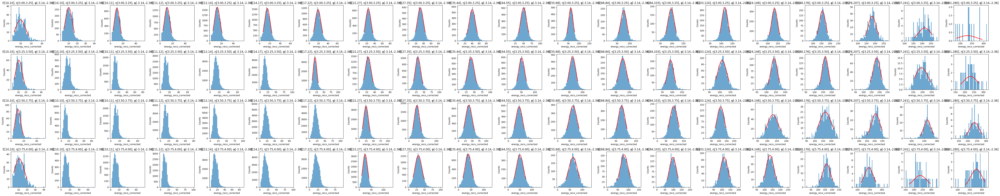

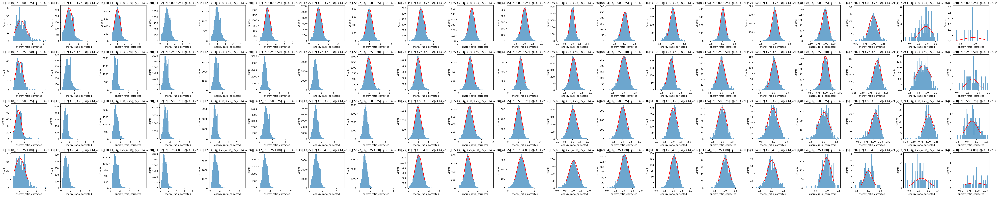

Processing phi bin 1: -2.36–-1.57


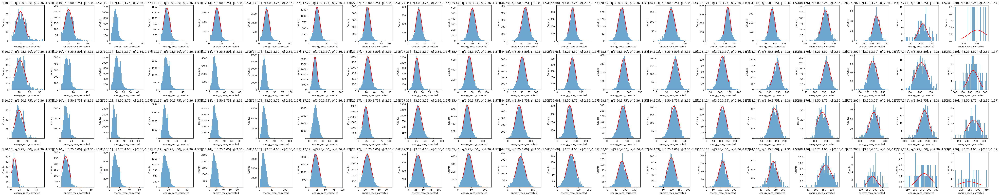

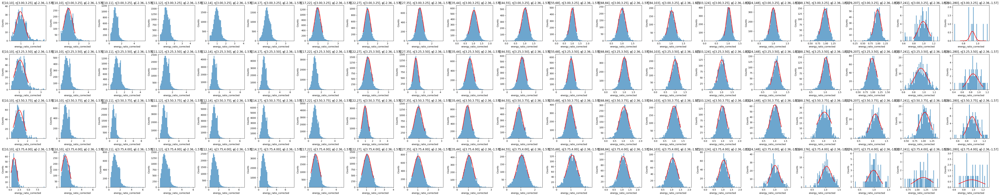

Processing phi bin 2: -1.57–-0.79


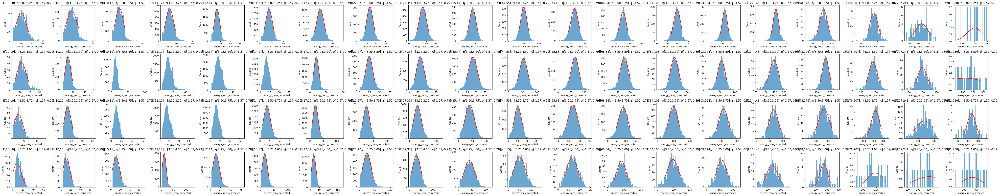

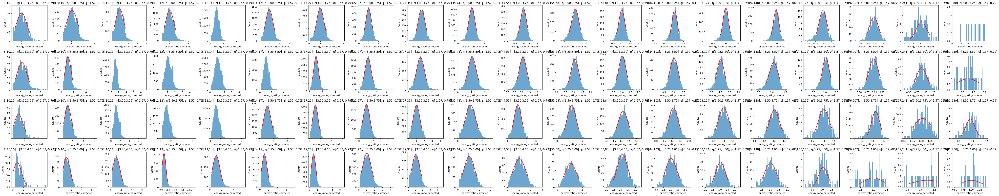

Processing phi bin 3: -0.79–0.00


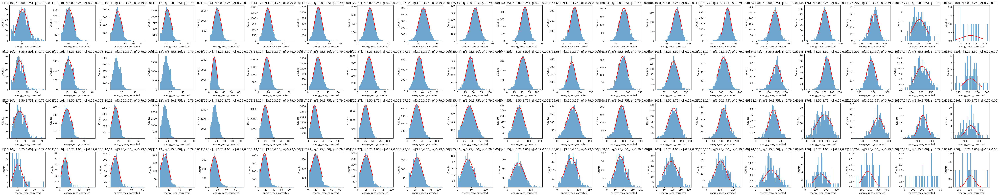

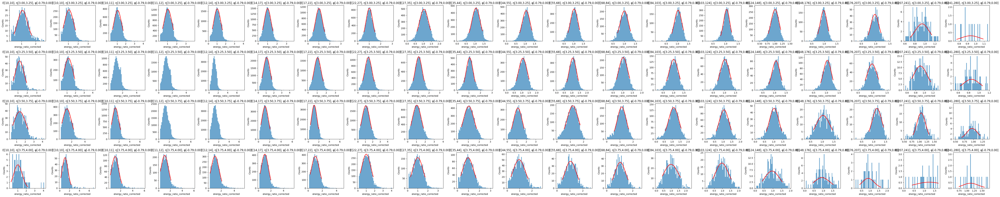

Processing phi bin 4: 0.00–0.79


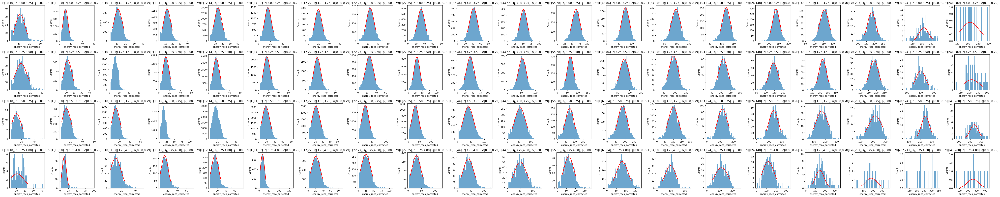

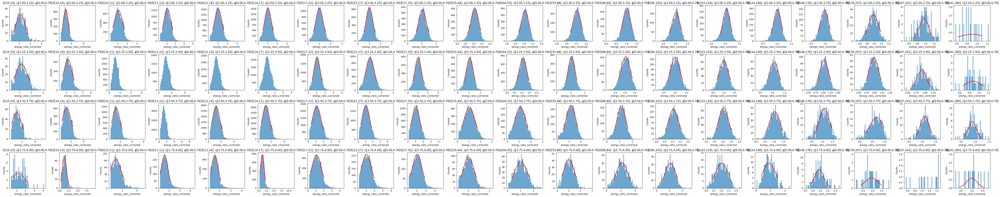

Processing phi bin 5: 0.79–1.57


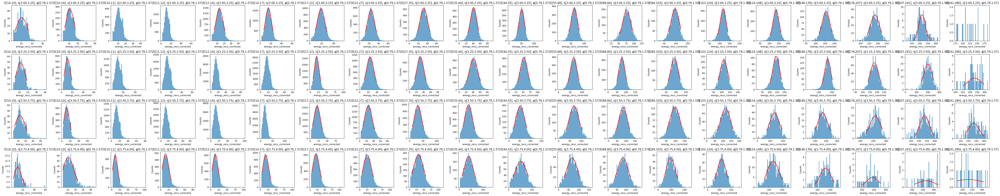

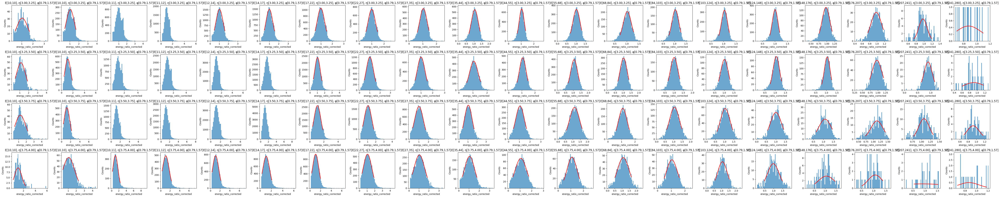

Processing phi bin 6: 1.57–2.36


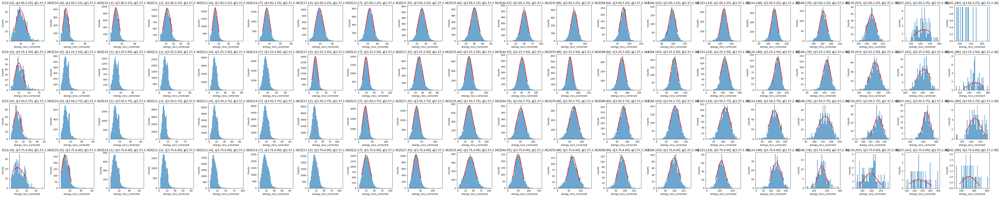

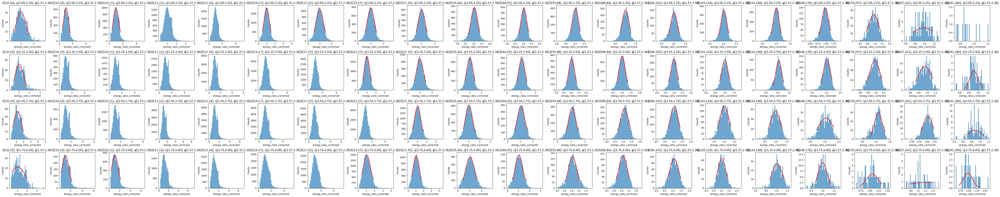

Processing phi bin 7: 2.36–3.14


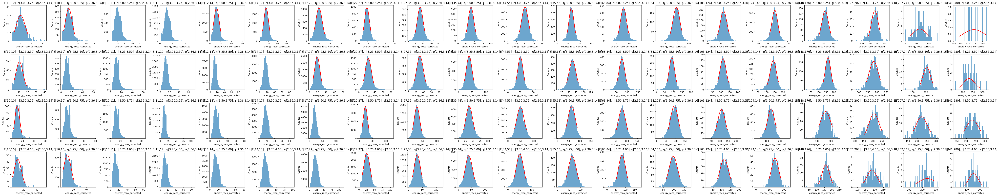

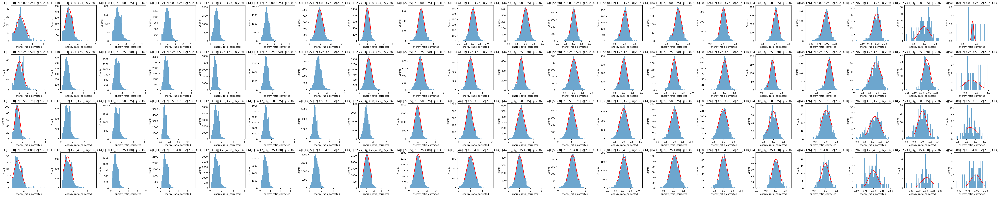

In [11]:
fit_results_response_corr = []
fit_results_scale_corr = []


# ======================================================
# Main Loop over φ, η, energy
# ======================================================
for k in range(len(phi_bins)-1):
    phi_low, phi_high = phi_bins[k], phi_bins[k+1]
    phi_center = 0.5*(phi_low + phi_high)

    print(f"Processing phi bin {k}: {phi_low:.2f}–{phi_high:.2f}")

    # ------------------------------------------------------
    # Create figure grids for this φ slice
    # ------------------------------------------------------
    fig_resp, axes_resp = plt.subplots(
        len(eta_bins)-1, len(e_bins)-1,
        figsize=(3*(len(e_bins)-1), 3*(len(eta_bins)-1))
    )
    fig_scale, axes_scale = plt.subplots(
        len(eta_bins)-1, len(e_bins)-1,
        figsize=(3*(len(e_bins)-1), 3*(len(eta_bins)-1))
    )

    # Ensure 2D array indexing
    if axes_resp.ndim == 1:
        axes_resp = np.expand_dims(axes_resp, axis=0)
    if axes_scale.ndim == 1:
        axes_scale = np.expand_dims(axes_scale, axis=0)

    # ------------------------------------------------------
    # Loop over η
    # ------------------------------------------------------
    for j in range(len(eta_bins)-1):
        eta_low, eta_high = eta_bins[j], eta_bins[j+1]
        eta_center = 0.5*(eta_low + eta_high)

        # ------------------------------------------------------
        # Loop over energy
        # ------------------------------------------------------
        for i in range(len(e_bins)-1):
            e_low, e_high = e_bins[i], e_bins[i+1]
            center_energy = 0.5*(e_low + e_high)

            ax_resp = axes_resp[j, i]
            ax_scale = axes_scale[j, i]

            # ------------------------------------------------------
            # Mask including φ
            # ------------------------------------------------------
            mask = (
                (paired["energy_truth"] >= e_low) &
                (paired["energy_truth"] <  e_high) &
                (paired["eta_reco"]    >= eta_low) &
                (paired["eta_reco"]    <  eta_high) &
                (paired["phi_reco"]    >= phi_low) &
                (paired["phi_reco"]    <  phi_high)
            )

            reco_in_bin  = paired.loc[mask, "energy_reco_corrected"].values
            ratio_in_bin = paired.loc[mask, "energy_ratio_corrected"].values

            # Titles
            title = (
                f"E[{e_low:.0f},{e_high:.0f}], "
                f"η[{eta_low:.2f},{eta_high:.2f}], "
                f"φ[{phi_low:.2f},{phi_high:.2f}]"
            )
            ax_resp.set_title(title)
            ax_resp.set_xlabel("energy_reco_corrected")
            ax_resp.set_ylabel("Counts")
            ax_scale.set_title(title)
            ax_scale.set_xlabel("energy_ratio_corrected")
            ax_scale.set_ylabel("Counts")

            # Histograms
            if len(reco_in_bin) > 0:
                ax_resp.hist(reco_in_bin, bins=n_hist_bins, alpha=0.65)
            if len(ratio_in_bin) > 0:
                ax_scale.hist(ratio_in_bin, bins=n_hist_bins, alpha=0.65)

            # ------------------------------------------------------
            # RESPONSE FIT
            # ------------------------------------------------------
            if len(reco_in_bin) >= min_points_for_fit:

                mu0 = reco_in_bin.mean()
                sigma0 = reco_in_bin.std()

                fit_mask = (
                    (reco_in_bin >= mu0 - n_sigma*sigma0) &
                    (reco_in_bin <= mu0 + n_sigma*sigma0*asym)
                )
                reco_fit_region = reco_in_bin[fit_mask]

                if len(reco_fit_region) >= min_points_for_fit:

                    counts, edges = np.histogram(reco_in_bin, bins=n_hist_bins)
                    bin_centers = 0.5*(edges[:-1] + edges[1:])
                    bin_widths  = np.diff(edges)
                    total_entries = counts.sum()

                    density = counts / (total_entries * bin_widths)
                    errors = np.sqrt(counts) / (total_entries * bin_widths)
                    errors[errors == 0] = errors[errors > 0].min()

                    fit_mask_bins = (
                        (bin_centers >= mu0 - n_sigma*sigma0) &
                        (bin_centers <= mu0 + n_sigma*sigma0*asym)
                    )

                    x_fit = bin_centers[fit_mask_bins]
                    y_fit = density[fit_mask_bins]
                    y_err = errors[fit_mask_bins]

                    if len(x_fit) >= 3:

                        p0 = [y_fit.max(), mu0, sigma0]
                        try:
                            popt, pcov = curve_fit(
                                gauss, x_fit, y_fit,
                                p0=p0, sigma=y_err,
                                absolute_sigma=True
                            )
                            mu_fit, sigma_fit = popt[1], popt[2]
                            mu_err, sigma_err = np.sqrt(np.diag(pcov))[1:3]
                            chi2_ndf = reduced_chi2(
                                y_fit, gauss(x_fit, *popt), y_err
                            )

                            valid_mu = (
                                mu0 - n_sigma*sigma0 <= mu_fit <=
                                mu0 + n_sigma*sigma0*asym
                            )

                            if chi2_ndf <= chi2_lim and valid_mu:

                                fit_results_response_corr.append({
                                    "center_energy": center_energy,
                                    "energy_range": (e_low, e_high),
                                    "eta_center": eta_center,
                                    "eta_range": (eta_low, eta_high),
                                    "phi_center": phi_center,
                                    "phi_range": (phi_low, phi_high),
                                    "mu": mu_fit,
                                    "mu_err": mu_err,
                                    "sigma": sigma_fit,
                                    "sigma_err": sigma_err,
                                    "chi2_ndf": chi2_ndf
                                })

                                # Plot Gaussian overlay
                                x_dense = np.linspace(
                                    mu0 - n_sigma*sigma0,
                                    mu0 + n_sigma*sigma0*asym, 400
                                )
                                y_dense = gauss(x_dense, *popt)
                                ax_resp.plot(
                                    x_dense,
                                    y_dense * total_entries * bin_widths.mean(),
                                    "r-", linewidth=2
                                )

                        except (RuntimeError, ValueError):
                            pass

            # ------------------------------------------------------
            # SCALE FIT
            # ------------------------------------------------------
            if len(ratio_in_bin) >= min_points_for_fit:

                mu0_r = ratio_in_bin.mean()
                sigma0_r = ratio_in_bin.std()

                fit_mask_r = (
                    (ratio_in_bin >= mu0_r - n_sigma*sigma0_r) &
                    (ratio_in_bin <= mu0_r + n_sigma*sigma0_r*asym)
                )
                ratio_fit_region = ratio_in_bin[fit_mask_r]

                if len(ratio_fit_region) >= min_points_for_fit:

                    counts_r, edges_r = np.histogram(
                        ratio_in_bin, bins=n_hist_bins
                    )
                    bin_centers_r = 0.5*(edges_r[:-1] + edges_r[1:])
                    bin_widths_r  = np.diff(edges_r)
                    total_entries_r = counts_r.sum()

                    density_r = counts_r / (total_entries_r * bin_widths_r)
                    errors_r = np.sqrt(counts_r) / (total_entries_r * bin_widths_r)
                    errors_r[errors_r == 0] = errors_r[errors_r > 0].min()

                    fit_mask_bins_r = (
                        (bin_centers_r >= mu0_r - n_sigma*sigma0_r) &
                        (bin_centers_r <= mu0_r + n_sigma*sigma0_r*asym)
                    )

                    x_fit_r = bin_centers_r[fit_mask_bins_r]
                    y_fit_r = density_r[fit_mask_bins_r]
                    y_err_r = errors_r[fit_mask_bins_r]

                    if len(x_fit_r) >= 3:

                        p0_r = [y_fit_r.max(), mu0_r, sigma0_r]

                        try:
                            popt_r, pcov_r = curve_fit(
                                gauss, x_fit_r, y_fit_r,
                                p0=p0_r, sigma=y_err_r,
                                absolute_sigma=True
                            )
                            mu_fit_r, sigma_fit_r = popt_r[1], popt_r[2]
                            mu_err_r, sigma_err_r = np.sqrt(np.diag(pcov_r))[1:3]
                            chi2_ndf_r = reduced_chi2(
                                y_fit_r, gauss(x_fit_r, *popt_r), y_err_r
                            )

                            valid_mu_r = (
                                mu0_r - n_sigma*sigma0_r <= mu_fit_r <=
                                mu0_r + n_sigma*sigma0_r*asym
                            )

                            if chi2_ndf_r <= chi2_lim and valid_mu_r:

                                fit_results_scale_corr.append({
                                    "center_energy": center_energy,
                                    "energy_range": (e_low, e_high),
                                    "eta_center": eta_center,
                                    "eta_range": (eta_low, eta_high),
                                    "phi_center": phi_center,
                                    "phi_range": (phi_low, phi_high),
                                    "mu": mu_fit_r,
                                    "mu_err": mu_err_r,
                                    "sigma": sigma_fit_r,
                                    "sigma_err": sigma_err_r,
                                    "chi2_ndf": chi2_ndf_r
                                })

                                x_dense_r = np.linspace(
                                    mu0_r - n_sigma*sigma0_r,
                                    mu0_r + n_sigma*sigma0_r*asym, 400
                                )
                                y_dense_r = gauss(x_dense_r, *popt_r)
                                ax_scale.plot(
                                    x_dense_r,
                                    y_dense_r * total_entries_r * bin_widths_r.mean(),
                                    "r-", linewidth=2
                                )

                        except (RuntimeError, ValueError):
                            pass

    # End phi slice plots
    fig_resp.tight_layout()
    fig_scale.tight_layout()
    plt.show()


# ======================================================
# Build final DataFrames
# ======================================================
df_fit_response_corr = pd.DataFrame(fit_results_response_corr)
df_fit_scale_corr = pd.DataFrame(fit_results_scale_corr)

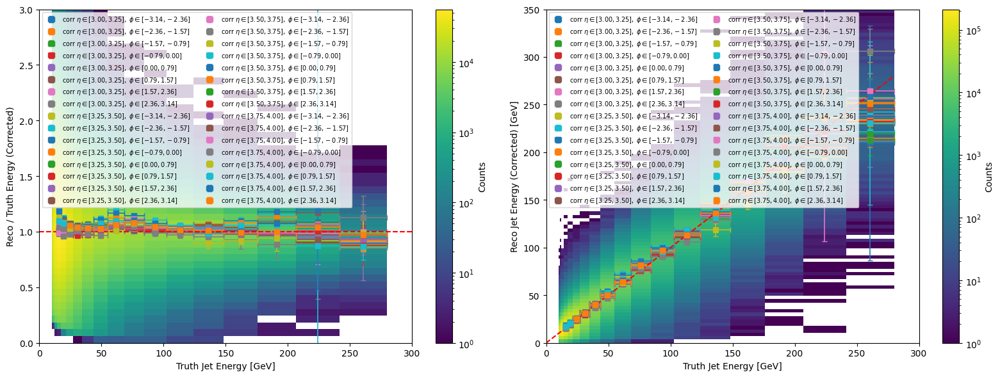

In [12]:
mask = df_fit_response_corr["center_energy"] > truth_ecut
df_fit_response_corr = df_fit_response_corr[mask].copy()

mask = df_fit_scale_corr["center_energy"] > truth_ecut
df_fit_scale_corr = df_fit_scale_corr[mask].copy()

# --- 2D histogram parameters ---
x_bins = e_bins
y_bins_ratio = np.linspace(0, 3, 50)
y_bins_reco = np.linspace(0, 350, 100)

fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharex=True)

# ==========================================================
# (1) Energy scale (ratio)
# ==========================================================
ax = axes[0]

hist_ratio = ax.hist2d(
    paired["energy_truth"],
    paired["energy_ratio_corrected"],    # <-- corrected ratio
    bins=[x_bins, y_bins_ratio],
    cmap="viridis",
    norm=mcolors.LogNorm()
)
fig.colorbar(hist_ratio[3], ax=ax, label="Counts")
ax.set_xlabel("Truth Jet Energy [GeV]")
ax.set_ylabel("Reco / Truth Energy (Corrected)")

# ----------------------------------------------------------
# Overlay eta–phi binned scale fits (corrected)
# ----------------------------------------------------------
for (eta_range, phi_range), df_sel in df_fit_scale_corr.groupby(
    [df_fit_scale_corr["eta_range"].apply(tuple),
     df_fit_scale_corr["phi_range"].apply(tuple)]
):
    e_range_width = 0.5 * df_sel["energy_range"].apply(lambda x: x[1]-x[0])

    eta_label = f"[{eta_range[0]:.2f},{eta_range[1]:.2f}]"
    phi_label = f"[{phi_range[0]:.2f},{phi_range[1]:.2f}]"

    ax.errorbar(
        df_sel["center_energy"],
        df_sel["mu"],            # corrected mean
        yerr=df_sel["mu_err"],
        xerr=e_range_width,
        fmt='s',                 # square → corrected
        elinewidth=1.2,
        capsize=3,
        label=fr"corr $\eta\in{eta_label},\ \phi\in{phi_label}$"
    )


ax.axhline(1.0, color='red', linestyle='--', lw=1.5)
ax.legend(fontsize=7, ncol=2)

# ==========================================================
# (2) Energy response (Reco energy corrected)
# ==========================================================
ax = axes[1]

hist_reco = ax.hist2d(
    paired["energy_truth"],
    paired["energy_reco_corrected"],    # <-- corrected reco
    bins=[x_bins, y_bins_reco],
    cmap="viridis",
    norm=mcolors.LogNorm()
)
fig.colorbar(hist_reco[3], ax=ax, label="Counts")
ax.set_xlabel("Truth Jet Energy [GeV]")
ax.set_ylabel("Reco Jet Energy (Corrected) [GeV]")
ax.set_xlim(0, 300)

# ----------------------------------------------------------
# Corrected response fit points
# ----------------------------------------------------------
for (eta_range, phi_range), df_sel in df_fit_response_corr.groupby(
    [df_fit_response_corr["eta_range"].apply(tuple),
     df_fit_response_corr["phi_range"].apply(tuple)]
):
    e_range_width = 0.5 * df_sel["energy_range"].apply(lambda x: x[1]-x[0])

    eta_label = f"[{eta_range[0]:.2f},{eta_range[1]:.2f}]"
    phi_label = f"[{phi_range[0]:.2f},{phi_range[1]:.2f}]"

    ax.errorbar(
        df_sel["center_energy"],
        df_sel["mu"],    # corrected mean
        yerr=df_sel["mu_err"],
        xerr=e_range_width,
        fmt='s',
        elinewidth=1.2,
        capsize=3,
        label=fr"corr $\eta\in{eta_label},\ \phi\in{phi_label}$"
    )


# diagonal line
x_line = np.array([0, x_bins.max()])
ax.plot(x_line, x_line, color='red', linestyle='--', lw=1.5)
ax.legend(fontsize=7, ncol=2)

plt.tight_layout()
plt.show()


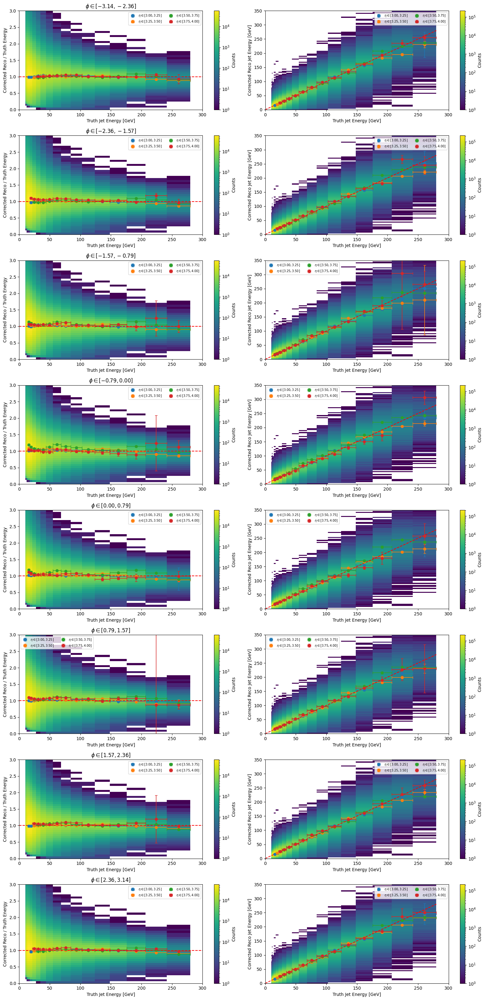

In [20]:
truth_ecut = 15

mask = df_fit_response_corr["center_energy"] > truth_ecut
df_fit_response_corr = df_fit_response_corr[mask].copy()

mask = df_fit_scale_corr["center_energy"] > truth_ecut
df_fit_scale_corr = df_fit_scale_corr[mask].copy()

# --- 2D histogram parameters ---
x_bins = e_bins
y_bins_ratio = np.linspace(0, 3, 50)
y_bins_reco = np.linspace(0, 350, 100)

# ==========================================================
# Unique phi bins
# ==========================================================
phi_bins_unique = df_fit_scale_corr["phi_range"].apply(tuple).unique()
phi_bins_unique = sorted(phi_bins_unique)  # clean ordering

n_phi = len(phi_bins_unique)

# ==========================================================
# Construct figure with rows = phi bins, columns = (ratio, reco)
# ==========================================================
fig, axes = plt.subplots(
    n_phi, 2,
    figsize=(16, 4 * n_phi)
)

# If only one phi bin, axes won't be 2D
if n_phi == 1:
    axes = np.array([axes])

# ==========================================================
# Loop over phi bins
# ==========================================================
for i, phi_range in enumerate(phi_bins_unique):

    # ------------------------------------------------------
    # (1) Energy Scale (ratio)
    # ------------------------------------------------------
    ax = axes[i, 0]

    hist_ratio = ax.hist2d(
        paired["energy_truth"],
        paired["energy_ratio_corrected"],
        bins=[x_bins, y_bins_ratio],
        cmap="viridis",
        norm=mcolors.LogNorm()
    )
    fig.colorbar(hist_ratio[3], ax=ax, label="Counts")

    ax.set_ylabel("Corrected Reco / Truth Energy")
    #if i == n_phi - 1:
    ax.set_xlabel("Truth Jet Energy [GeV]")

    # Overlay scale fit (group by eta for this phi)
    for eta_range, df_sel in (
        df_fit_scale_corr[df_fit_scale_corr["phi_range"].apply(tuple) == phi_range]
        .groupby(df_fit_scale_corr["eta_range"].apply(tuple))
    ):
        e_range_width = 0.5 * df_sel["energy_range"].apply(lambda x: x[1] - x[0])

        eta_label = f"[{eta_range[0]:.2f},{eta_range[1]:.2f}]"
        phi_label = f"[{phi_range[0]:.2f},{phi_range[1]:.2f}]"

        ax.errorbar(
            df_sel["center_energy"],
            df_sel["mu"],
            yerr=df_sel["mu_err"],
            xerr=e_range_width,
            fmt='o',
            elinewidth=1.2,
            capsize=3,
            label=fr"$\eta\in{eta_label}$"
        )
    ax.set_xlim(0, 300)
    ax.axhline(1.0, color='red', linestyle='--', lw=1.5)
    ax.set_title(fr"$\phi\in[{phi_range[0]:.2f},{phi_range[1]:.2f}]$")
    ax.legend(fontsize=7, ncol=2)

    # ------------------------------------------------------
    # (2) Energy Response (absolute reco)
    # ------------------------------------------------------
    ax = axes[i, 1]

    hist_reco = ax.hist2d(
        paired["energy_truth"],
        paired["energy_reco_corrected"],
        bins=[x_bins, y_bins_reco],
        cmap="viridis",
        norm=mcolors.LogNorm()
    )
    fig.colorbar(hist_reco[3], ax=ax, label="Counts")

    #if i == n_phi - 1:
    ax.set_xlabel("Truth Jet Energy [GeV]")
    ax.set_ylabel("Corrected Reco Jet Energy [GeV]")
    ax.set_xlim(0, 300)

    for eta_range, df_sel in (
        df_fit_response_corr[df_fit_response_corr["phi_range"].apply(tuple) == phi_range]
        .groupby(df_fit_response_corr["eta_range"].apply(tuple))
    ):
        e_range_width = 0.5 * df_sel["energy_range"].apply(lambda x: x[1] - x[0])

        eta_label = f"[{eta_range[0]:.2f},{eta_range[1]:.2f}]"

        ax.errorbar(
            df_sel["center_energy"],
            df_sel["mu"],
            yerr=df_sel["mu_err"],
            xerr=e_range_width,
            fmt='o',
            elinewidth=1.2,
            capsize=3,
            label=fr"$\eta\in{eta_label}$"
        )

    x_line = np.array([0, x_bins.max()])
    ax.plot(x_line, x_line, color='red', linestyle='--', lw=1.5)
    ax.legend(fontsize=7, ncol=2)

plt.tight_layout()
plt.show()


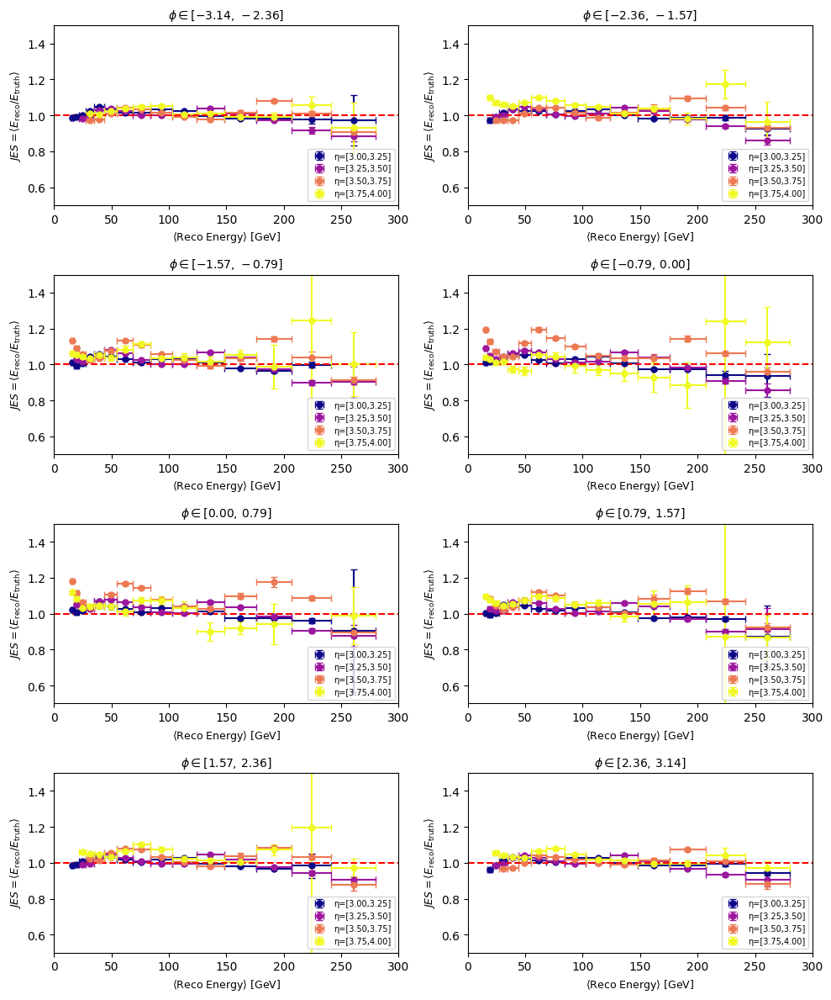

In [13]:
# ------------------------------------------------------------
# Use corrected data only
# ------------------------------------------------------------
mask = df_fit_response_corr["center_energy"] > truth_ecut
df_fit_response_corr = df_fit_response_corr[mask].copy()

mask = df_fit_scale_corr["center_energy"] > truth_ecut
df_fit_scale_corr = df_fit_scale_corr[mask].copy()

# Determine eta and phi ranges present in corrected data
phi_ranges = sorted({tuple(phi) for phi in df_fit_scale_corr["phi_range"]})
eta_ranges = sorted({tuple(eta) for eta in df_fit_scale_corr["eta_range"]})

# 4×2 grid
nrows, ncols = 4, 2
fig, axes = plt.subplots(nrows, ncols, figsize=(10, 12), sharex=False, sharey=False)
axes = axes.flatten()

# Colors per eta range
colors = plt.cm.plasma(np.linspace(0, 1, len(eta_ranges)))
eta_color = dict(zip(eta_ranges, colors))

# ------------------------------------------------------------
# Plot corrected points only (no spline)
# ------------------------------------------------------------
for ax_idx, phi_range in enumerate(phi_ranges):
    if ax_idx >= len(axes):
        break
    ax = axes[ax_idx]

    handles_local = []  # legend handles per subplot
    labels_local = []   # legend labels per subplot

    for eta_range in eta_ranges:

        df_bin = df_fit_scale_corr[
            (df_fit_scale_corr["eta_range"].apply(tuple) == eta_range) &
            (df_fit_scale_corr["phi_range"].apply(tuple) == phi_range)
        ]

        if len(df_bin) == 0:
            continue

        color = eta_color[eta_range]

        x_vals = df_bin["center_energy"].values
        y_vals = df_bin["mu"].values
        x_err = 0.5 * df_bin["energy_range"].apply(lambda r: r[1] - r[0]).values
        y_err = df_bin["mu_err"].values

        label = f"η=[{eta_range[0]:.2f},{eta_range[1]:.2f}]"

        h = ax.errorbar(
            x_vals, y_vals,
            xerr=x_err, yerr=y_err,
            fmt='o', color=color, ecolor=color, capsize=3,
            markersize=5
        )

        handles_local.append(h)
        labels_local.append(label)

    ax.axhline(1.0, color='red', linestyle='--', linewidth=1.5)
    ax.set_xlim(0, 300)
    ax.set_ylim(0.5, 1.5)

    ax.set_title(
        rf"$\phi \in [{phi_range[0]:.2f},\,{phi_range[1]:.2f}]$",
        fontsize=10
    )

    ax.set_xlabel(r"$\langle \mathrm{Reco\ Energy} \rangle$ [GeV]", fontsize=9)
    ax.set_ylabel(r"$JES = \langle E_\mathrm{reco}/E_\mathrm{truth} \rangle$", fontsize=9)

    # Legend inside subplot
    ax.legend(handles_local, labels_local, fontsize=7, loc="lower right")

# Hide unused panels
for k in range(len(phi_ranges), len(axes)):
    axes[k].set_visible(False)

plt.tight_layout()
plt.show()


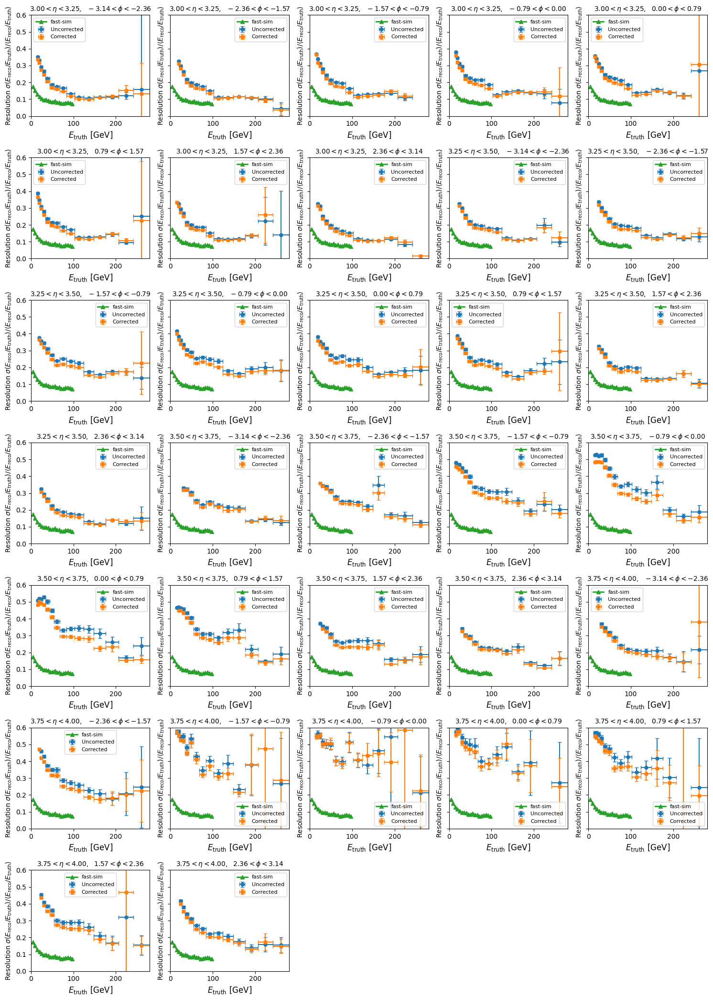

In [23]:
df_uncorr = df_fit_scale.copy()
df_corr = df_fit_scale_corr.copy()

# --- Load external data (fast-sim) ---
fastsim_df = pd.read_csv("resolution.csv")
fastsim_df.columns = fastsim_df.columns.str.strip()
x_fastsim = fastsim_df["x"].values
y_fastsim = fastsim_df["y"].values

# --- Unique (eta, phi) ranges ---
eta_phi_ranges = df_uncorr.groupby([
    df_uncorr["eta_range"].apply(tuple),
    df_uncorr["phi_range"].apply(tuple)
]).groups.keys()

eta_phi_ranges = list(eta_phi_ranges)
n_bins = len(eta_phi_ranges)

def compute_resolution(df):
    x = np.array([(low + high) / 2 for low, high in df["energy_range"]])
    xerr = np.array([(high - low) / 2 for low, high in df["energy_range"]])
    mu = df["mu"].values
    sigma = df["sigma"].values
    mu_err = df["mu_err"].values
    sigma_err = df["sigma_err"].values
    resolution = sigma / mu
    resolution_err = resolution * np.sqrt((sigma_err / sigma)**2 + (mu_err / mu)**2)
    return x, xerr, resolution, resolution_err

# --- Plot grid setup ---
max_cols = 5
cols = min(n_bins, max_cols)
rows = int(np.ceil(n_bins / max_cols))

fig, axes = plt.subplots(rows, cols, figsize=(3*cols, 3*rows), sharey=True)
axes = np.ravel(axes)

# --- Loop through each (eta, phi) bin ---
for i, (eta_range, phi_range) in enumerate(eta_phi_ranges):
    eta_low, eta_high = eta_range
    phi_low, phi_high = phi_range
    ax = axes[i]

    df_u = df_uncorr[
        (df_uncorr["eta_range"].apply(tuple) == eta_range) &
        (df_uncorr["phi_range"].apply(tuple) == phi_range)
    ]
    df_c = df_corr[
        (df_corr["eta_range"].apply(tuple) == eta_range) &
        (df_corr["phi_range"].apply(tuple) == phi_range)
    ]

    x_u, xerr_u, res_u, res_err_u = compute_resolution(df_u)
    x_c, xerr_c, res_c, res_err_c = compute_resolution(df_c)

    # --- uncorrected ---
    ax.errorbar(
        x_u, res_u,
        xerr=xerr_u, yerr=np.abs(res_err_u),
        fmt='o', capsize=3, markersize=5,
        label="Uncorrected"
    )

    # --- corrected ---
    ax.errorbar(
        x_c, res_c,
        xerr=xerr_c, yerr=np.abs(res_err_c),
        fmt='s', capsize=3, markersize=5,
        label="Corrected"
    )

    # --- fast-sim ---
    ax.plot(
        x_fastsim, y_fastsim,
        '-^', linewidth=2, markersize=6,
        label="fast-sim"
    )

    # axis setup
    ax.set_xlim(0, 280)
    ax.set_ylim(0, 0.6)
    ax.set_xlabel(r"$E_{\mathrm{truth}}\ [\mathrm{GeV}]$", fontsize=12)

    ax.set_title(
        r"$%.2f < \eta < %.2f,\ \ %.2f < \phi < %.2f$"
        % (eta_low, eta_high, phi_low, phi_high), fontsize=10
    )


    ax.set_ylabel(
        r"Resolution $\sigma(E_{\mathrm{reco}}/E_{\mathrm{truth}})/"
        r"\langle E_{\mathrm{reco}}/E_{\mathrm{truth}}\rangle$",
        fontsize=10
    )

    ax.legend(fontsize=8)

# Remove unused axes if any
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


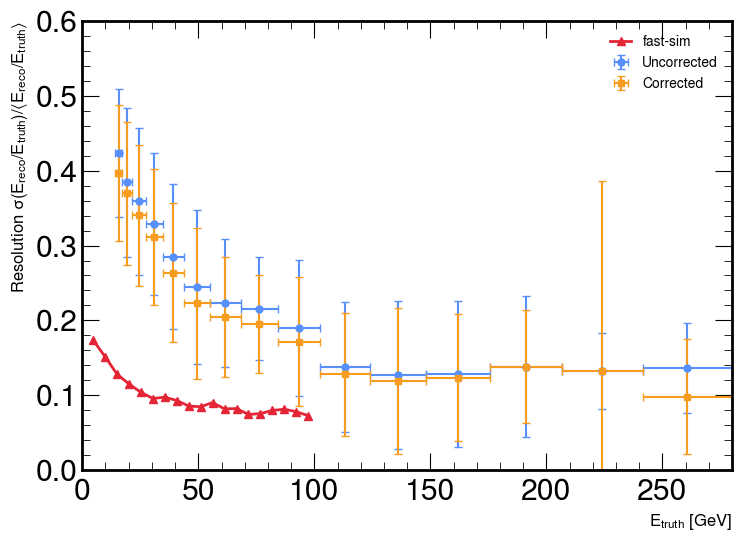

In [25]:
# --- Combine results across eta and phi bins ---
def average_over_eta_phi_with_scatter(df):
    grouped = df.groupby(df["energy_range"].apply(tuple))
    x_list, xerr_list, res_list, res_err_list = [], [], [], []

    for energy_range, df_bin in grouped:
        # Get resolution and errors for all contributing eta-phi bins
        x_vals, xerr_vals, res_vals, res_err_vals = compute_resolution(df_bin)

        # weighted average
        weights = 1 / np.maximum(res_err_vals**2, 1e-12)
        res_avg = np.sum(res_vals * weights) / np.sum(weights)

        # weighted mean error
        res_weighted_err = np.sqrt(1 / np.sum(weights))

        # scatter of the values themselves (unweighted)
        if len(res_vals) > 1:
            res_scatter = np.std(res_vals, ddof=1)
        else:
            res_scatter = 0.0

        # combine weighted error and scatter
        res_total_err = np.sqrt(res_weighted_err**2 + res_scatter**2)

        x_avg = np.mean(x_vals)
        xerr_avg = np.mean(xerr_vals)

        x_list.append(x_avg)
        xerr_list.append(xerr_avg)
        res_list.append(res_avg)
        res_err_list.append(res_total_err)

    return np.array(x_list), np.array(xerr_list), np.array(res_list), np.array(res_err_list)
    
configure_plotting()
# --- Compute averaged resolutions ---
x_u, xerr_u, res_u, res_err_u = average_over_eta_phi_with_scatter(df_uncorr)
x_c, xerr_c, res_c, res_err_c = average_over_eta_phi_with_scatter(df_corr)

# --- Plot summary ---
plt.figure(figsize=(8,6))

# uncorrected
plt.errorbar(x_u, res_u, xerr=xerr_u, yerr=res_err_u,
             fmt='o', capsize=3, markersize=5, label='Uncorrected')

# corrected
plt.errorbar(x_c, res_c, xerr=xerr_c, yerr=res_err_c,
             fmt='s', capsize=3, markersize=5, label='Corrected')

# fast-sim overlay
plt.plot(x_fastsim, y_fastsim, '-^', linewidth=2, markersize=6, label='fast-sim')

plt.xlabel(r"$E_{\mathrm{truth}}\ [\mathrm{GeV}]$", fontsize=12)
plt.ylabel(r"Resolution $\sigma(E_{\mathrm{reco}}/E_{\mathrm{truth}})/"
        r"\langle E_{\mathrm{reco}}/E_{\mathrm{truth}}\rangle$", fontsize=12)
plt.xlim(0, 280)
plt.ylim(0, 0.6)
plt.legend(fontsize=10)
plt.tight_layout()
plt.show()


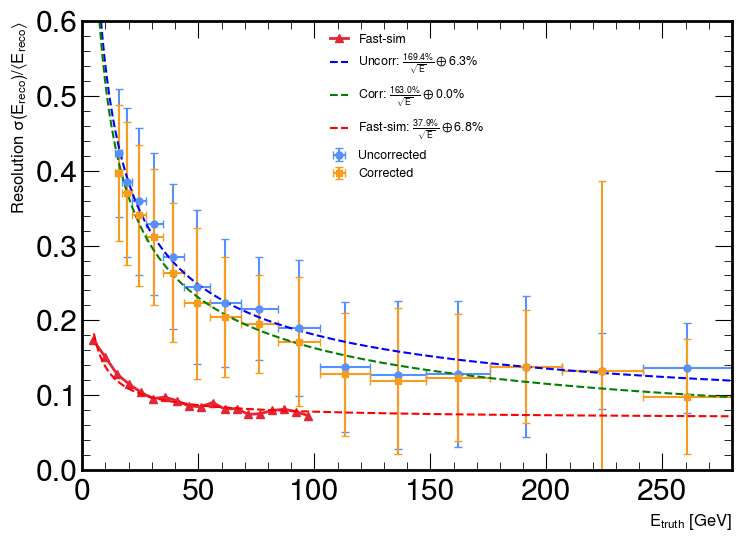

In [26]:
from scipy.optimize import curve_fit
import numpy as np
import matplotlib.pyplot as plt

# Simplified resolution function
def resolution_func_simple(E, A, B):
    return np.sqrt((A/np.sqrt(E))**2 + B**2)

# Fit function with bounds for A <= 0.2
def fit_resolution_bounded(x, y, yerr):
    p0 = [0.12, 0.02]  # initial guess
    bounds = ([0, 0], [100.0, 100.0])  # A in [0,0.2], B in [0,1]
    popt, pcov = curve_fit(resolution_func_simple, x, y, sigma=yerr, absolute_sigma=True,
                           p0=p0, bounds=bounds)
    return popt

# Fit uncorrected, corrected, and fast-sim
p_uncorr = fit_resolution_bounded(x_u, res_u, res_err_u)
p_corr   = fit_resolution_bounded(x_c, res_c, res_err_c)
p_fast   = fit_resolution_bounded(x_fastsim, y_fastsim, np.zeros_like(y_fastsim)+0.01)

# --- Plot summary with fits ---
plt.figure(figsize=(8,6))

plt.errorbar(x_u, res_u, xerr=xerr_u, yerr=res_err_u, fmt='o', capsize=3, markersize=5, label='Uncorrected')
plt.errorbar(x_c, res_c, xerr=xerr_c, yerr=res_err_c, fmt='s', capsize=3, markersize=5, label='Corrected')
plt.plot(x_fastsim, y_fastsim, '-^', linewidth=2, markersize=6, label='Fast-sim')

E_fine = np.linspace(5, 280, 300)

plt.plot(E_fine, resolution_func_simple(E_fine, *p_uncorr), 'b--',
         label=r"Uncorr: $\frac{{{:.1f}\%}}{{\sqrt{{E}}}} \oplus {:.1f}\%$".format(
             p_uncorr[0]*100, p_uncorr[1]*100))
plt.plot(E_fine, resolution_func_simple(E_fine, *p_corr), 'g--',
         label=r"Corr: $\frac{{{:.1f}\%}}{{\sqrt{{E}}}} \oplus {:.1f}\%$".format(
             p_corr[0]*100, p_corr[1]*100))
plt.plot(E_fine, resolution_func_simple(E_fine, *p_fast), 'r--',
         label=r"Fast-sim: $\frac{{{:.1f}\%}}{{\sqrt{{E}}}} \oplus {:.1f}\%$".format(
             p_fast[0]*100, p_fast[1]*100))

plt.xlabel(r"$E_{\mathrm{truth}}\ [\mathrm{GeV}]$", fontsize=12)
plt.ylabel(r"Resolution $\sigma(E_{\mathrm{reco}})/\langle E_{\mathrm{reco}}\rangle$", fontsize=12)
plt.xlim(0, 280)
plt.ylim(0, 0.6)
plt.legend(fontsize=9)
plt.tight_layout()
plt.show()
